In [1]:
## Preliminary

In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
from collections import Counter
import matplotlib.pyplot as plt
plt.style.use('seaborn')
import seaborn as sns
from statsmodels.graphics.gofplots import qqplot
import plotly.express as px
from sklearn.model_selection import train_test_split, GridSearchCV

!pip install mitosheet 
import mitosheet 

!pip install xgboost
import xgboost

%config InlineBackend.figure_format = "svg"

In [3]:
df = pd.read_csv('../datasets/train.csv')

In [4]:
df.head()

,property_id,property_name,property_summary,property_space,property_desc,property_neighborhood,property_notes,property_transit,property_access,property_interaction,...,reviews_rating,reviews_acc,reviews_cleanliness,reviews_checkin,reviews_communication,reviews_location,reviews_value,reviews_per_month,extra,target
0,1,"Chambre à louer,courte durée.","Je loue une chambre dans mon appartement ""atyp...","Espace duplex très grand et lumineux,la chambr...","Je loue une chambre dans mon appartement ""atyp...",NaN,NaN,Accès direct de la Gare du Nord ( 4 arrêts de...,NaN,Je suis entièrement disponible pour tout échan...,...,97.0,10.0,9.0,10.0,10.0,9.0,10.0,1.31,Host Has Profile Pic,26
1,2,Urban Antwerp - Spacious & Authentic Herenhouse,Our place is a typical historic herenhuis clos...,The spaces in our house are all large with hig...,Our place is a typical historic herenhuis clos...,Bar and restaurants One of our favourite bars ...,NaN,In Antwerp we have the system with rental bike...,You will be able to access the following space...,We are always available to help and assist whe...,...,100.0,10.0,10.0,10.0,10.0,8.0,10.0,1.00,"Host Has Profile Pic, Is Location Exact",75
2,3,comfortable apartment in friendly neighborhood,Nice and cozy apartment for couples who like t...,Nice proper and clean apartment. No personal s...,Nice and cozy apartment for couples who like t...,Op 5 minuten lopen zijn er 2 gezellig stadpark...,Public transport is next to the apartment and ...,Fiets verhuur voor de deur. (dag/weekkaart) vi...,As a good host I trust my guest. No secrets an...,"Ik ben altijd bereikbaar voor vragen, maar ben...",...,93.0,10.0,10.0,9.0,9.0,9.0,10.0,0.75,"Host Has Profile Pic, Is Location Exact, Insta...",110
3,4,Historical City Antwerp.,The best place to stay if you like to be in th...,Our rooms are nice and spacious. You stay in a...,The best place to stay if you like to be in th...,In the middle of the historical city of Antwerp,Staying in our house you have to be able to cl...,Tram 10 and 11 from Central station stop in ou...,Beside your own room you can relax in the down...,We will be available to let you know where wha...,...,98.0,10.0,10.0,10.0,10.0,10.0,10.0,6.90,"Host Is Superhost, Host Has Profile Pic, Host ...",60
4,5,Antwerp center city,Our place is right in the heart of the histori...,It is situated in the center if the old town. ...,Our place is right in the heart of the histori...,The neighborhood is in the historical part of ...,NaN,The easiest is just to walk into the city ther...,You will enter the house through the Downstair...,I will be present to help you out with any kin...,...,97.0,10.0,10.0,10.0,10.0,10.0,10.0,4.16,"Host Is Superhost, Host Has Profile Pic, Host ...",55


In [5]:
# First, we eliminate irrelevant columns and columns with too many missing values

In [6]:
mitosheet.sheet(df, analysis_to_replay="id-vkoubkyuyu")

In [7]:
from mitosheet.public.v2 import *; register_analysis("id-vkoubkyuyu");

# Deleted columns property_id
df.drop(['property_id'], axis=1, inplace=True)

# Deleted columns property_name
df.drop(['property_name'], axis=1, inplace=True)

# Deleted columns property_summary
df.drop(['property_summary'], axis=1, inplace=True)

# Deleted columns property_space
df.drop(['property_space'], axis=1, inplace=True)

# Deleted columns property_desc
df.drop(['property_desc'], axis=1, inplace=True)

# Deleted columns property_neighborhood
df.drop(['property_neighborhood'], axis=1, inplace=True)

# Deleted columns property_notes
df.drop(['property_notes'], axis=1, inplace=True)

# Deleted columns property_transit
df.drop(['property_transit'], axis=1, inplace=True)

# Deleted columns property_access
df.drop(['property_access'], axis=1, inplace=True)

# Deleted columns property_interaction
df.drop(['property_interaction'], axis=1, inplace=True)

# Deleted columns property_rules
df.drop(['property_rules'], axis=1, inplace=True)

# Deleted columns property_zipcode
df.drop(['property_zipcode'], axis=1, inplace=True)

# Deleted columns property_type
df.drop(['property_type'], axis=1, inplace=True)

# Deleted columns property_bed_type
df.drop(['property_bed_type'], axis=1, inplace=True)

# Deleted columns property_sqfeet
df.drop(['property_sqfeet'], axis=1, inplace=True)

# Deleted columns property_scraped_at
df.drop(['property_scraped_at'], axis=1, inplace=True)

# Deleted columns property_last_updated
df.drop(['property_last_updated'], axis=1, inplace=True)

# Deleted columns host_id
df.drop(['host_id'], axis=1, inplace=True)

# Deleted columns host_since
df.drop(['host_since'], axis=1, inplace=True)

# Deleted columns host_location
df.drop(['host_location'], axis=1, inplace=True)

# Deleted columns host_about
df.drop(['host_about'], axis=1, inplace=True)

# Deleted columns host_response_time
df.drop(['host_response_time'], axis=1, inplace=True)

# Deleted columns host_response_rate
df.drop(['host_response_rate'], axis=1, inplace=True)

# Deleted columns host_nr_listings
df.drop(['host_nr_listings'], axis=1, inplace=True)

# Deleted columns host_nr_listings_total
df.drop(['host_nr_listings_total'], axis=1, inplace=True)

# Deleted columns host_verified
df.drop(['host_verified'], axis=1, inplace=True)

# Deleted columns booking_price_covers
df.drop(['booking_price_covers'], axis=1, inplace=True)

# Deleted columns booking_max_nights
df.drop(['booking_max_nights'], axis=1, inplace=True)

# Deleted columns booking_availability_30
df.drop(['booking_availability_30'], axis=1, inplace=True)

# Deleted columns booking_availability_60
df.drop(['booking_availability_60'], axis=1, inplace=True)

# Deleted columns booking_availability_90
df.drop(['booking_availability_90'], axis=1, inplace=True)

# Deleted columns booking_availability_365
df.drop(['booking_availability_365'], axis=1, inplace=True)

# Deleted columns reviews_first
df.drop(['reviews_first'], axis=1, inplace=True)

# Deleted columns reviews_last
df.drop(['reviews_last'], axis=1, inplace=True)

# Deleted columns reviews_acc
df.drop(['reviews_acc'], axis=1, inplace=True)

# Deleted columns reviews_cleanliness
df.drop(['reviews_cleanliness'], axis=1, inplace=True)

# Deleted columns reviews_checkin
df.drop(['reviews_checkin'], axis=1, inplace=True)

# Deleted columns reviews_communication
df.drop(['reviews_communication'], axis=1, inplace=True)

# Deleted columns reviews_location
df.drop(['reviews_location'], axis=1, inplace=True)

# Deleted columns reviews_value
df.drop(['reviews_value'], axis=1, inplace=True)

# Deleted columns extra
df.drop(['extra'], axis=1, inplace=True)

In [8]:
df.describe()

,property_lat,property_lon,property_max_guests,property_bathrooms,property_bedrooms,property_beds,booking_min_nights,reviews_num,reviews_rating,reviews_per_month,target
count,6495.000000,6495.000000,6495.000000,6483.000000,6486.000000,6484.000000,6495.000000,6495.000000,5112.000000,5205.000000,6495.000000
mean,50.902186,4.372070,2.999076,1.141293,1.205982,1.742751,3.531948,18.989069,91.692879,1.667712,67.899923
std,0.142571,0.031946,1.778460,0.456293,0.750513,1.339657,16.569408,36.851232,8.999618,1.992615,51.910478
min,50.769144,4.268333,1.000000,0.000000,0.000000,1.000000,1.000000,0.000000,20.000000,0.010000,10.000000
25%,50.828595,4.347677,2.000000,1.000000,1.000000,1.000000,1.000000,1.000000,89.000000,0.310000,40.000000
50%,50.843198,4.367556,2.000000,1.000000,1.000000,1.000000,2.000000,5.000000,93.000000,0.910000,55.000000
75%,50.859380,4.395064,4.000000,1.000000,1.000000,2.000000,3.000000,19.000000,98.000000,2.270000,80.000000
max,51.360545,4.483468,16.000000,8.000000,8.000000,16.000000,1000.000000,386.000000,100.000000,19.900000,950.000000


In [9]:
# property_bathrooms

In [10]:
df.property_bathrooms.isna().sum()

12

In [11]:
df['property_bathrooms'] = df['property_bathrooms'].fillna(1)

In [12]:
# property_bedrooms

In [13]:
df.property_bedrooms.isna().sum()

9

In [14]:
df['property_bedrooms'] = df['property_bedrooms'].fillna(1)

In [15]:
# property_beds

In [16]:
df['property_beds'] = df['property_beds'].fillna(2)

In [17]:
# booking_min_nights

In [18]:
df = df[df['booking_min_nights'] <= 10]

In [19]:
# reviews_num

In [20]:
df = df[df['reviews_num'] <= 40]

In [21]:
# reviews_rating

In [22]:
df['reviews_rating'] = df['reviews_rating'].fillna(0)

In [23]:
# reviews_per_month

In [24]:
df = df[df['reviews_per_month'] <= 10]

In [25]:
df['reviews_per_month'] = df['reviews_per_month'].fillna(0)

In [26]:
# property_amenities

In [27]:
df = df.dropna(subset=['property_amenities'])

In [28]:
# target

In [29]:
df = df[df['target'] <= 500]

In [30]:
df.describe()

,property_lat,property_lon,property_max_guests,property_bathrooms,property_bedrooms,property_beds,booking_min_nights,reviews_num,reviews_rating,reviews_per_month,target
count,4152.000000,4152.000000,4152.000000,4152.000000,4152.000000,4152.000000,4152.000000,4152.000000,4152.000000,4152.000000,4152.000000
mean,50.903882,4.372629,3.025771,1.140896,1.219171,1.741089,2.097543,9.847062,89.759393,1.195925,65.951830
std,0.144314,0.031978,1.740739,0.413159,0.753144,1.317257,1.438157,9.689841,16.117332,1.458035,44.840031
min,50.769144,4.281896,1.000000,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.010000,10.000000
25%,50.828198,4.347968,2.000000,1.000000,1.000000,1.000000,1.000000,2.000000,88.000000,0.240000,40.000000
50%,50.841964,4.369029,2.000000,1.000000,1.000000,1.000000,2.000000,6.000000,93.000000,0.680000,55.000000
75%,50.861106,4.395321,4.000000,1.000000,1.000000,2.000000,2.000000,14.000000,99.000000,1.520000,79.000000
max,51.349402,4.483468,16.000000,8.000000,8.000000,16.000000,10.000000,40.000000,100.000000,10.000000,500.000000


In [31]:
df.isna().sum()


property_lat             0
property_lon             0
property_room_type       0
property_max_guests      0
property_bathrooms       0
property_bedrooms        0
property_beds            0
property_amenities       0
booking_min_nights       0
booking_cancel_policy    0
reviews_num              0
reviews_rating           0
reviews_per_month        0
target                   0
dtype: int64

In [32]:
df.head()

,property_lat,property_lon,property_room_type,property_max_guests,property_bathrooms,property_bedrooms,property_beds,property_amenities,booking_min_nights,booking_cancel_policy,reviews_num,reviews_rating,reviews_per_month,target
0,50.858451,4.376594,Private room,1,1.0,1.0,1.0,"Internet, Wireless Internet, Kitchen, Smoking ...",1,flexible,23,97.0,1.31,26
1,51.194744,4.413748,Entire home/apt,4,1.5,2.0,2.0,"TV, Cable TV, Wireless Internet, Kitchen, Brea...",2,flexible,1,100.0,1.00,75
2,51.192501,4.409351,Entire home/apt,2,1.0,1.0,1.0,"Wireless Internet, Kitchen, Free parking on pr...",2,flexible,4,93.0,0.75,110
5,50.830194,4.350654,Private room,2,2.0,1.0,1.0,"TV, Internet, Wireless Internet, Kitchen, Smok...",1,moderate,7,94.0,3.56,139
6,50.802914,4.336662,Entire home/apt,6,1.0,3.0,3.0,"Wireless Internet, Kitchen, Heating, Family/ki...",3,strict,5,92.0,0.13,85


In [33]:
# verder werken

In [34]:
#amenities_list = []
#
#for element in df.property_amenities:
#    element = element[1:]
#    element = element[:-1]
#    x = element.split()
#    amenities_list.append(len(x))

#df.property_amenities = amenities_list
df.drop(['property_amenities'], axis=1, inplace=True)


In [35]:
df.head()

,property_lat,property_lon,property_room_type,property_max_guests,property_bathrooms,property_bedrooms,property_beds,booking_min_nights,booking_cancel_policy,reviews_num,reviews_rating,reviews_per_month,target
0,50.858451,4.376594,Private room,1,1.0,1.0,1.0,1,flexible,23,97.0,1.31,26
1,51.194744,4.413748,Entire home/apt,4,1.5,2.0,2.0,2,flexible,1,100.0,1.00,75
2,51.192501,4.409351,Entire home/apt,2,1.0,1.0,1.0,2,flexible,4,93.0,0.75,110
5,50.830194,4.350654,Private room,2,2.0,1.0,1.0,1,moderate,7,94.0,3.56,139
6,50.802914,4.336662,Entire home/apt,6,1.0,3.0,3.0,3,strict,5,92.0,0.13,85


In [36]:
property_room_type = pd.get_dummies(df.property_room_type).astype(int)

In [37]:
booking_cancel_policy = pd.get_dummies(df.booking_cancel_policy).astype(int)

In [38]:
df = df.drop(['property_room_type', 'booking_cancel_policy'], axis = 1)
df = pd.concat((df, property_room_type, booking_cancel_policy), axis = 1)

In [39]:
df = df[df['super_strict_30'] != 1]
df = df.drop('super_strict_30', axis=1)

In [40]:
df.head()

,property_lat,property_lon,property_max_guests,property_bathrooms,property_bedrooms,property_beds,booking_min_nights,reviews_num,reviews_rating,reviews_per_month,target,Entire home/apt,Private room,Shared room,flexible,moderate,strict
0,50.858451,4.376594,1,1.0,1.0,1.0,1,23,97.0,1.31,26,0,1,0,1,0,0
1,51.194744,4.413748,4,1.5,2.0,2.0,2,1,100.0,1.00,75,1,0,0,1,0,0
2,51.192501,4.409351,2,1.0,1.0,1.0,2,4,93.0,0.75,110,1,0,0,1,0,0
5,50.830194,4.350654,2,2.0,1.0,1.0,1,7,94.0,3.56,139,0,1,0,0,1,0
6,50.802914,4.336662,6,1.0,3.0,3.0,3,5,92.0,0.13,85,1,0,0,0,0,1


In [41]:
# import train_test_split function
from sklearn.model_selection import train_test_split
# import metrics
from sklearn.metrics import mean_squared_error, r2_score

# create target and features
a = df.drop(['target'], axis = 1)
b = df.target

# split our data
X_train, X_test, y_train, y_test = train_test_split(a, b, test_size=0.2, random_state=13)

In [42]:
# scale data and normalize the features
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test  = sc.transform(X_test)

In [43]:
from sklearn import linear_model
from sklearn import metrics

# linear regression testing
reg = linear_model.LinearRegression()
reg.fit(X_train, y_train)
r2_lr = metrics.r2_score(y_test, reg.predict(X_test))

y_test_pred = reg.predict(X_test)
y_train_pred = reg.predict(X_train)

print (f"r2: {round(r2_lr, 5)}")

r2: 0.00359


In [44]:
# ridge model testing
ridge = linear_model.Ridge()
ridge.fit(X_train, y_train)
r2_rr = metrics.r2_score(y_test, ridge.predict(X_test))

y_test_pred = ridge.predict(X_test)
y_train_pred = ridge.predict(X_train)

print (f"r2: {round(r2_rr, 5)}")

r2: 0.00383


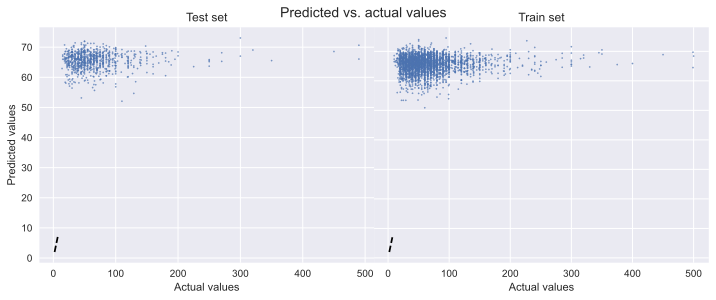

In [45]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
fig.suptitle('Predicted vs. actual values', fontsize=14, y=1)
plt.subplots_adjust(top=0.93, wspace=0)
    
ax1.scatter(y_test, y_test_pred, s=2, alpha=0.7)
ax1.plot(list(range(2,8)), list(range(2,8)), color='black', linestyle='--')
ax1.set_title('Test set')
ax1.set_xlabel('Actual values')
ax1.set_ylabel('Predicted values')
    
ax2.scatter(y_train, y_train_pred, s=2, alpha=0.7)
ax2.plot(list(range(2,8)), list(range(2,8)), color='black', linestyle='--')
ax2.set_title('Train set')
ax2.set_xlabel('Actual values')
ax2.set_ylabel('')
ax2.set_yticklabels(labels='')

plt.show()

In [46]:
import xgboost as xgb
# create a baseline
booster = xgb.XGBRegressor()

In [47]:
from sklearn.model_selection import GridSearchCV

# create Grid of parameters
param_grid = {'n_estimators': [100, 150, 200],
              'learning_rate': [0.01, 0.05, 0.1], 
              'max_depth': [3, 4, 5, 6, 7],
              'colsample_bytree': [0.6, 0.7, 1],
              'gamma': [0.0, 0.1, 0.2]}

# instantiate the tuned random forest
booster_grid_search = GridSearchCV(booster, param_grid, cv=3, n_jobs=-1)

# train the tuned random forest
booster_grid_search.fit(X_train, y_train)

# print best estimator parameters found during the grid search
print(booster_grid_search.best_params_)

{'colsample_bytree': 0.6, 'gamma': 0.0, 'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 100}


In [48]:
# instantiate xgboost with the most optimal parameters
booster = xgb.XGBRegressor(colsample_bytree=0.6, gamma=0.2, learning_rate=0.05, 
                           max_depth=7, n_estimators=100, random_state=4)

# train the model
booster.fit(X_train, y_train)

# predict the values
y_pred_train = booster.predict(X_train)
y_pred_test = booster.predict(X_test)

In [49]:
RMSE = np.sqrt(mean_squared_error(y_test, y_pred_test))
print(f"RMSE: {round(RMSE, 5)}")

RMSE: 48.93346


In [50]:
r2 = r2_score(y_test, y_pred_test)
r2
print(f"r2: {round(r2, 5)}")

r2: -0.02352


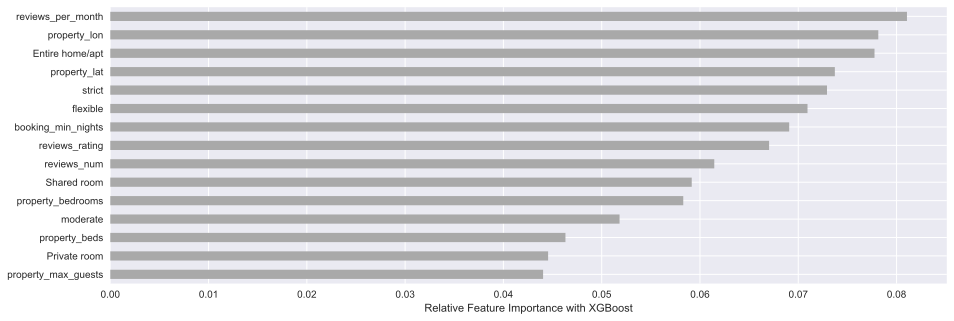

In [51]:
# plot the important features
features_importance = pd.Series(booster.feature_importances_, index=a.columns)
features_importance.nlargest(15).sort_values().plot(kind='barh', color='darkgrey', figsize=(15,5))
plt.xlabel('Relative Feature Importance with XGBoost');

In [52]:
## Oke nu laden we de test set en doen we alles idem

In [53]:
test = pd.read_csv('../datasets/test.csv')

In [54]:
test.head()

,property_id,property_name,property_summary,property_space,property_desc,property_neighborhood,property_notes,property_transit,property_access,property_interaction,...,reviews_last,reviews_rating,reviews_acc,reviews_cleanliness,reviews_checkin,reviews_communication,reviews_location,reviews_value,reviews_per_month,extra
0,6501,Apartment in the center of Brussels,Lovely and sunny apartment with spacious livin...,The apartment is located in the 4th floor of a...,Lovely and sunny apartment with spacious livin...,The neighborhood is the real center of Brussel...,"All the facilities are included ( cleaning , ...","All the facilities are included ( cleaning , t...","All the facilities are included ( cleaning , b...",I will be always available by phone for everyt...,...,2017-05-08,89.0,9.0,9.0,9.0,10.0,9.0,9.0,9.26,Host Has Profile Pic
1,6502,Sous-location pendant l'été,"Situé à quelques pas de Meiser, une grande mai...",NaN,"Situé à quelques pas de Meiser, une grande mai...",NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Host Has Profile Pic
2,6503,Two bedrooms flat near city center,Nice fully furnish and equipped apartment with...,The flat is situated in Molenbeek-Saint-Jean b...,Nice fully furnish and equipped apartment with...,The flat is located at the border of the city ...,"If you need a parking spot, there is a garage ...",There are many tram and bus lines near to the ...,There is a small shops two doors further and l...,I will be in Brussels for the period I rent th...,...,2017-04-02,95.0,9.0,7.0,9.0,9.0,8.0,9.0,0.15,"Host Has Profile Pic, Host Identity Verified, ..."
3,6504,Newly refurbished flat in the heart of Brussels,"Eurostar, Thalys, TGV, Metro, Tram, Bus. Resta...","Set in the heart of Brussels, this newly refur...","Eurostar, Thalys, TGV, Metro, Tram, Bus. Resta...",The neighbourhood is very safe and family-frie...,NaN,"Very close to Gare du Midi, one of the major s...",All spaces within the apartment are available ...,"Yes, I will be there if needed and I will be t...",...,2017-05-07,86.0,9.0,9.0,9.0,10.0,8.0,9.0,4.04,"Host Has Profile Pic, Host Identity Verified, ..."
4,6505,Large double bedroom in a semi-detached villa (g),"My place is close to Stockel Metro, Avenue de ...",NaN,"My place is close to Stockel Metro, Avenue de ...",NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Host Has Profile Pic, Host Identity Verified, ..."


In [55]:
# Deleted columns property_id
test.drop(['property_id'], axis=1, inplace=True)

# Deleted columns property_name
test.drop(['property_name'], axis=1, inplace=True)

# Deleted columns property_summary
test.drop(['property_summary'], axis=1, inplace=True)

# Deleted columns property_space
test.drop(['property_space'], axis=1, inplace=True)

# Deleted columns property_desc
test.drop(['property_desc'], axis=1, inplace=True)

# Deleted columns property_neighborhood
test.drop(['property_neighborhood'], axis=1, inplace=True)

# Deleted columns property_notes
test.drop(['property_notes'], axis=1, inplace=True)

# Deleted columns property_transit
test.drop(['property_transit'], axis=1, inplace=True)

# Deleted columns property_access
test.drop(['property_access'], axis=1, inplace=True)

# Deleted columns property_interaction
test.drop(['property_interaction'], axis=1, inplace=True)

# Deleted columns property_rules
test.drop(['property_rules'], axis=1, inplace=True)

# Deleted columns property_zipcode
test.drop(['property_zipcode'], axis=1, inplace=True)

# Deleted columns property_type
test.drop(['property_type'], axis=1, inplace=True)

# Deleted columns property_bed_type
test.drop(['property_bed_type'], axis=1, inplace=True)

# Deleted columns property_sqfeet
test.drop(['property_sqfeet'], axis=1, inplace=True)

# Deleted columns property_scraped_at
test.drop(['property_scraped_at'], axis=1, inplace=True)

# Deleted columns property_last_updated
test.drop(['property_last_updated'], axis=1, inplace=True)

# Deleted columns host_id
test.drop(['host_id'], axis=1, inplace=True)

# Deleted columns host_since
test.drop(['host_since'], axis=1, inplace=True)

# Deleted columns host_location
test.drop(['host_location'], axis=1, inplace=True)

# Deleted columns host_about
test.drop(['host_about'], axis=1, inplace=True)

# Deleted columns host_response_time
test.drop(['host_response_time'], axis=1, inplace=True)

# Deleted columns host_response_rate
test.drop(['host_response_rate'], axis=1, inplace=True)

# Deleted columns host_nr_listings
test.drop(['host_nr_listings'], axis=1, inplace=True)

# Deleted columns host_nr_listings_total
test.drop(['host_nr_listings_total'], axis=1, inplace=True)

# Deleted columns host_verified
test.drop(['host_verified'], axis=1, inplace=True)

# Deleted columns booking_price_covers
test.drop(['booking_price_covers'], axis=1, inplace=True)

# Deleted columns booking_max_nights
test.drop(['booking_max_nights'], axis=1, inplace=True)

# Deleted columns booking_availability_30
test.drop(['booking_availability_30'], axis=1, inplace=True)

# Deleted columns booking_availability_60
test.drop(['booking_availability_60'], axis=1, inplace=True)

# Deleted columns booking_availability_90
test.drop(['booking_availability_90'], axis=1, inplace=True)

# Deleted columns booking_availability_365
test.drop(['booking_availability_365'], axis=1, inplace=True)

# Deleted columns reviews_first
test.drop(['reviews_first'], axis=1, inplace=True)

# Deleted columns reviews_last
test.drop(['reviews_last'], axis=1, inplace=True)

# Deleted columns reviews_acc
test.drop(['reviews_acc'], axis=1, inplace=True)

# Deleted columns reviews_cleanliness
test.drop(['reviews_cleanliness'], axis=1, inplace=True)

# Deleted columns reviews_checkin
test.drop(['reviews_checkin'], axis=1, inplace=True)

# Deleted columns reviews_communication
test.drop(['reviews_communication'], axis=1, inplace=True)

# Deleted columns reviews_location
test.drop(['reviews_location'], axis=1, inplace=True)

# Deleted columns reviews_value
test.drop(['reviews_value'], axis=1, inplace=True)

# Deleted columns extra
test.drop(['extra'], axis=1, inplace=True)

In [56]:
test.head()

,property_lat,property_lon,property_room_type,property_max_guests,property_bathrooms,property_bedrooms,property_beds,property_amenities,booking_min_nights,booking_cancel_policy,reviews_num,reviews_rating,reviews_per_month
0,50.852199,4.356610,Entire home/apt,4,1.0,1,2.0,"TV, Internet, Wireless Internet, Kitchen, Heat...",1,moderate,208,89.0,9.26
1,50.849707,4.393422,Entire home/apt,1,2.5,1,1.0,"Wireless Internet, Kitchen, Heating, Suitable ...",6,flexible,0,NaN,NaN
2,50.849058,4.335249,Entire home/apt,4,1.5,2,3.0,"Internet, Wireless Internet, Wheelchair access...",2,flexible,5,95.0,0.15
3,50.841093,4.333263,Entire home/apt,2,1.0,1,1.0,"TV, Cable TV, Internet, Wireless Internet, Kit...",1,moderate,38,86.0,4.04
4,50.832869,4.449680,Private room,2,1.5,1,1.0,"Wireless Internet, Kitchen, Free parking on pr...",1,flexible,0,NaN,NaN


In [57]:
test['property_bathrooms'] = test['property_bathrooms'].fillna(1)

In [58]:
test['property_bedrooms'] = test['property_bedrooms'].fillna(1)

In [59]:
test['reviews_rating'] = test['reviews_rating'].fillna(90)

In [60]:
test['reviews_per_month'] = test['reviews_per_month'].fillna(0)

In [61]:
test['property_amenities'] = test['property_amenities'].fillna('')

In [62]:
test.head()

,property_lat,property_lon,property_room_type,property_max_guests,property_bathrooms,property_bedrooms,property_beds,property_amenities,booking_min_nights,booking_cancel_policy,reviews_num,reviews_rating,reviews_per_month
0,50.852199,4.356610,Entire home/apt,4,1.0,1,2.0,"TV, Internet, Wireless Internet, Kitchen, Heat...",1,moderate,208,89.0,9.26
1,50.849707,4.393422,Entire home/apt,1,2.5,1,1.0,"Wireless Internet, Kitchen, Heating, Suitable ...",6,flexible,0,90.0,0.00
2,50.849058,4.335249,Entire home/apt,4,1.5,2,3.0,"Internet, Wireless Internet, Wheelchair access...",2,flexible,5,95.0,0.15
3,50.841093,4.333263,Entire home/apt,2,1.0,1,1.0,"TV, Cable TV, Internet, Wireless Internet, Kit...",1,moderate,38,86.0,4.04
4,50.832869,4.449680,Private room,2,1.5,1,1.0,"Wireless Internet, Kitchen, Free parking on pr...",1,flexible,0,90.0,0.00


In [63]:
#amenities_list_test = []
#
#for element in test.property_amenities:
#    element = element[1:]
#    element = element[:-1]
#    x = element.split()
#    amenities_list_test.append(len(x))
#
#test.property_amenities = amenities_list_test
test.drop(['property_amenities'], axis=1, inplace=True)

In [64]:
property_room_type_test = pd.get_dummies(test.property_room_type).astype(int)

In [65]:
booking_cancel_policy_test = pd.get_dummies(test.booking_cancel_policy).astype(int)

In [66]:
test.head()

,property_lat,property_lon,property_room_type,property_max_guests,property_bathrooms,property_bedrooms,property_beds,booking_min_nights,booking_cancel_policy,reviews_num,reviews_rating,reviews_per_month
0,50.852199,4.356610,Entire home/apt,4,1.0,1,2.0,1,moderate,208,89.0,9.26
1,50.849707,4.393422,Entire home/apt,1,2.5,1,1.0,6,flexible,0,90.0,0.00
2,50.849058,4.335249,Entire home/apt,4,1.5,2,3.0,2,flexible,5,95.0,0.15
3,50.841093,4.333263,Entire home/apt,2,1.0,1,1.0,1,moderate,38,86.0,4.04
4,50.832869,4.449680,Private room,2,1.5,1,1.0,1,flexible,0,90.0,0.00


In [67]:
test = test.drop(['property_room_type', 'booking_cancel_policy'], axis = 1)
test = pd.concat((test, property_room_type_test, booking_cancel_policy_test), axis = 1)

In [68]:
test

,property_lat,property_lon,property_max_guests,property_bathrooms,property_bedrooms,property_beds,booking_min_nights,reviews_num,reviews_rating,reviews_per_month,Entire home/apt,Private room,Shared room,flexible,moderate,strict
0,50.852199,4.356610,4,1.0,1,2.0,1,208,89.0,9.26,1,0,0,0,1,0
1,50.849707,4.393422,1,2.5,1,1.0,6,0,90.0,0.00,1,0,0,1,0,0
2,50.849058,4.335249,4,1.5,2,3.0,2,5,95.0,0.15,1,0,0,1,0,0
3,50.841093,4.333263,2,1.0,1,1.0,1,38,86.0,4.04,1,0,0,0,1,0
4,50.832869,4.449680,2,1.5,1,1.0,1,0,90.0,0.00,0,1,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
914,50.851233,4.344952,2,1.0,0,1.0,2,30,98.0,5.08,1,0,0,0,0,1
915,50.870983,4.344691,2,1.0,0,1.0,3,9,100.0,4.03,1,0,0,1,0,0
916,51.253027,4.444755,2,1.0,1,1.0,5,0,90.0,0.00,1,0,0,1,0,0
917,50.863660,4.368558,3,1.0,1,2.0,7,6,97.0,0.15,1,0,0,0,1,0


In [69]:
# Get predictions for test set
predictions = booster.predict(test).astype(int)
predictions = np.ceil(predictions)

# Add predictions as a new column to the DataFrame
test['predictions'] = predictions

# Export the DataFrame to a CSV file
test.to_csv('test_predicted2.csv', index=False)

In [70]:
predictions

array([53., 45., 36., 64., 49., 49., 45., 40., 42., 47., 49., 42., 45.,
       44., 57., 44., 43., 47., 39., 35., 39., 43., 36., 53., 49., 52.,
       45., 44., 40., 38., 50., 46., 45., 47., 36., 41., 41., 42., 46.,
       37., 41., 35., 51., 48., 46., 50., 47., 45., 41., 46., 44., 37.,
       42., 38., 48., 44., 36., 38., 38., 36., 41., 44., 43., 37., 34.,
       46., 43., 40., 40., 46., 42., 66., 43., 42., 48., 42., 46., 40.,
       41., 51., 45., 44., 57., 44., 42., 42., 46., 52., 42., 43., 37.,
       39., 48., 49., 40., 43., 51., 52., 36., 35., 52., 36., 48., 42.,
       40., 46., 46., 41., 35., 53., 47., 45., 35., 52., 60., 38., 48.,
       45., 46., 43., 53., 43., 41., 58., 49., 42., 43., 43., 43., 49.,
       47., 40., 34., 38., 50., 51., 54., 35., 41., 56., 56., 46., 46.,
       52., 55., 42., 44., 50., 41., 41., 45., 41., 45., 40., 36., 38.,
       41., 60., 41., 45., 46., 44., 45., 55., 41., 44., 41., 34., 51.,
       42., 41., 40., 50., 49., 44., 48., 43., 48., 49., 42., 50

In [71]:
import os

# Get the path to the desktop
desktop_path = os.path.expanduser("~/Desktop")

# Export the DataFrame to a CSV file on the desktop
test.to_csv(os.path.join(desktop_path, "test_predicted2.csv"), index=False)
